In [1]:
from dotenv import load_dotenv

import cv2
import os
import numpy as np
import torch
import torchvision.transforms as T
from torchvision.models.segmentation import deeplabv3_resnet101
import matplotlib.pyplot as plt

from pathlib import Path

import json

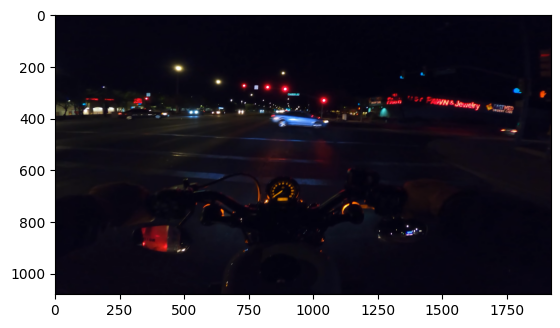

In [2]:
class PathManager:
    """환경 및 모듈 간 규격 클래스"""
    """상황에 맞게 경로와 규격을 수정 후 사용할 것"""
    
    def __init__(self, default_size: int | None = None):
        """dotenv 위치 찾기 + 로드"""
        self.root_path = self._find_root()
        self.dotenv_path = self.root_path / ".env" # 또는 self.dotenv_path = self.root_path / ".env"
        load_dotenv(self.dotenv_path)

        """이미지와 모델 디렉토리 인식"""
        self._images_dir = self.root_path / "data/images"
        self._models_dir = self.root_path / "models"
        self._datas_dir = self.root_path / "data"
        self.default_size = default_size

        self.image_name = None
        self.model_name = None

    def _find_root(self, marker: str=".env") -> Path: # 외부에서 호출할 일 없다.
        """프로젝트 최상단 경로를 찾는 함수"""
        """.env를 마커로 사용"""
        current_cwd = Path().cwd().resolve()
        for parent in current_cwd.parents:
            if (parent / marker).exists():
                return parent

    def get_image_path(self, image_name: str) -> Path:
        """이미지 주소 획득"""
        self.image_name = image_name
        return self._images_dir / image_name
        
    def get_model_path(self, model_name: str) -> Path:
        """모델 주소 획득"""
        self.model_name = model_name
        return self._models_dir / model_name

    def get_data_path(self, data_name: str) -> Path:
        """데이터 주소 획득"""
        self.data_name = data_name
        return self._datas_dir / data_name

def run():
    path_manager = PathManager()

    # 기본 경로, 이미지 폴더 경로, 데이터 폴더 경로
    root_path = path_manager.root_path
    images_dir = path_manager._images_dir
    datas_dir = path_manager._datas_dir


    # 이미지 폴더 내의 이미지 경로
    my_image_path = path_manager.get_image_path("night ride (7).png")
    
    # 원본
    my_image_origin = cv2.imread(my_image_path)
    
    # 원본을 rgb로 변환 후 변수 저장
    my_image_rgb = cv2.cvtColor(my_image_origin, cv2.COLOR_BGR2RGB)

    # json 경로
    my_json_path = path_manager.get_data_path("COCO_motorcycle (pixel).json")
    
    # json 로드
    with open (my_json_path, "r", encoding="utf-8") as f:
        my_json_origin = json.load(f)

    # 시각화
    plt.imshow(my_image_rgb)
    plt.show

    return root_path, images_dir, datas_dir, my_json_origin

root_path, images_dir, datas_dir, my_json_origin = run()

In [3]:
my_json_origin

{'info': {'description': 'This is dataset.',
  'url': 'https://superannotate.ai',
  'version': '1.0',
  'year': 2022,
  'contributor': 'Superannotate AI',
  'date_created': '15/09/2022'},
 'licenses': [{'url': 'https://superannotate.ai',
   'id': 1,
   'name': 'Superannotate AI'}],
 'images': [{'id': 1,
   'file_name': 'night ride (8).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 2,
   'file_name': 'night ride (14).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 3,
   'file_name': 'night ride (11).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 4,
   'file_name': 'night ride (24).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 5,
   'file_name': 'night ride (23).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 6,
   'file_name': 'night ride (10).png',
   'height': 1080,
   'width': 1920,
   'license': 1},
  {'id': 7,
   'file_name': 'night ride (9).png',
   'height': 1080,
   

In [21]:
my_json_origin['categories']

[{'id': 1329681,
  'name': 'Rider',
  'supercategory': 'Rider',
  'isthing': 1,
  'color': [17, 74, 20]},
 {'id': 1323885,
  'name': 'My bike',
  'supercategory': 'My bike',
  'isthing': 1,
  'color': [109, 51, 20]},
 {'id': 1323884,
  'name': 'Moveable',
  'supercategory': 'Moveable',
  'isthing': 1,
  'color': [108, 51, 20]},
 {'id': 1323882,
  'name': 'Lane Mark',
  'supercategory': 'Lane Mark',
  'isthing': 1,
  'color': [106, 51, 20]},
 {'id': 1323881,
  'name': 'Road',
  'supercategory': 'Road',
  'isthing': 1,
  'color': [105, 51, 20]},
 {'id': 1323880,
  'name': 'Undrivable',
  'supercategory': 'Undrivable',
  'isthing': 1,
  'color': [104, 51, 20]}]

In [ ]:
transform = T.Compose([
    T.ToPILImage(),
    T.Resize((520, 520)),  # 모델 입력 크기 (고정)
    T.ToTensor(),
])

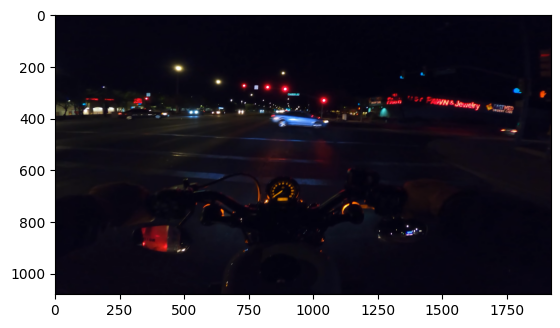

In [9]:
path_manager = PathManager()

image_path = path_manager.get_image_path("night ride (7).png")

my_image_origin = cv2.imread(image_path)
plt.imshow(my_image_origin)

my_image_rgb = cv2.cvtColor(my_image_origin, cv2.COLOR_BGR2RGB)
plt.imshow(my_image_rgb)

In [11]:
input_tensor = transform(cv2.cvtColor(my_image_origin, cv2.COLOR_BGR2RGB)).unsqueeze(0)
input_tensor.dtype

torch.float32

# 여기서부터 데이터셋 로드 작성

### 폴더에 있는 이미지 파일 가져오기

In [12]:
import os

# 1. 이미지 폴더 내의 모든 파일 리스트업
# PathManager의 속성을 활용합니다.
all_files = os.listdir(images_dir)

# 2. 이미지 확장자만 필터링 (순서가 달라도 상관없습니다, 이름으로 매칭할 거니까요)
valid_extensions = ('.png', '.jpg', '.jpeg')
image_files = [f for f in all_files if f.lower().endswith(valid_extensions)]

print(f"찾은 이미지 개수: {len(image_files)}장") # 여기서 200이 나와야 합니다.

찾은 이미지 개수: 600장


### 폴더에 있는 이미지 파일 중 save랑 fuse 제외하고 가져오기

In [20]:
# 1. 'save'와 'fuse'가 이름에 들어간 파일은 제외하고 순수 'night ride'와 'Screenshot'만 추출
# 리스트 컴프리헨션을 사용하여 조건부 필터링을 수행합니다.
image_files = [
    f for f in all_files 
    if f.lower().endswith(valid_extensions)
    and 'save' not in f.lower() 
    and 'fuse' not in f.lower()
]

print(f"정제된 이미지 개수: {len(image_files)}장") 
# 여기서 정확히 200장이 나오는지 확인하십시오.

print(image_files[99])

정제된 이미지 개수: 200장
Screenshot (317).png


### JSON과 입력파일이 실제로 매칭하는지 확인해서 매칭된것만 가져오기

In [16]:
# JSON에 등록된 모든 파일 이름을 집합(Set)으로 만듭니다. (검색 속도 최적화)
json_filenames = {img['file_name'] for img in my_json_origin['images']}

# 폴더에는 있지만 JSON에는 없는 유령 파일들을 걸러냅니다.
final_image_files = [f for f in image_files if f in json_filenames]

print(f"최종 매칭된 이미지 개수: {len(final_image_files)}장")

최종 매칭된 이미지 개수: 200장


In [19]:
from sklearn.model_selection import train_test_split

# 0. 팀원들끼리 공유할떄 시드값이 고정되어도 기본 파일정렬은 os마다 다를수 있습니다. 그래서 추가했습니다.
final_image_files = sorted(final_image_files)

# 1. 전체 200장에서 먼저 Test 20장(10%)을 분리합니다.
# 200 * 0.1 = 20
train_val_files, test_files = train_test_split(
    final_image_files, 
    test_size=0.1, 
    random_state=2026
)

# 2. 남은 180장에서 다시 Val 20장(약 11.1%)을 분리합니다.
# 180 * (20/180) = 20
train_files, val_files = train_test_split(
    train_val_files, 
    test_size=20/180, 
    random_state=2026
)

print(f"✅ 분리 완료 (Seed: 2026)")
print(f"훈련 데이터(Train): {len(train_files)}장")
print(f"검증 데이터(Val): {len(val_files)}장")
print(f"테스트 데이터(Test): {len(test_files)}장")

✅ 분리 완료 (Seed: 2026)
훈련 데이터(Train): 160장
검증 데이터(Val): 20장
테스트 데이터(Test): 20장


In [33]:
import cv2
import torch
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset


# [Config] 데이터셋 규격 정의
# 0번부터 5번까지 6개 클래스를 할당합니다.
CLASS_MAP = {
    'Undrivable': 0,
    'Road': 1,
    'Lane Mark': 2,
    'My bike': 3,
    'Rider': 4,
    'Moveable': 5
}

# 역매핑 (ID -> Name)은 필요할 때 내부에서 생성하거나 별도로 정의
ID_TO_NAME = {v: k for k, v in CLASS_MAP.items()}


class DeepLabDataset(Dataset):
    def __init__(self, image_paths, json_data, class_map):
        self.image_paths = image_paths
        self.json_data = json_data
        self.class_map = class_map
        
        # 520x5202 리사이즈 및 텐서 변환 설정
        self.transform = A.Compose([
            A.Resize(520, 520, interpolation=cv2.INTER_LINEAR),
            A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
            ToTensorV2()
        ])
        
        # 마스크 전용 리사이즈 (정수 값 유지를 위해 별도 처리하거나 Compose 내에서 mask_interpolation 설정)
        self.mask_resize = A.Resize(520, 520, interpolation=cv2.INTER_NEAREST)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        
        # 1. 원본 이미지 로드
        image = cv2.imread(str(img_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # 2. 마스크 생성 (기존에 정의한 7개 클래스 로직)
        # 1920x1080 원본 크기로 먼저 생성
        full_mask = self._generate_full_mask(img_path.name, (1080, 1920))

        # 3. 이미지와 마스크 동시 변환
        # Resize(520, 520) 적용
        transformed = self.mask_resize(image=image, mask=full_mask)
        transformed = self.transform(image=transformed['image'], mask=transformed['mask'])

        return transformed['image'], transformed['mask'].long()

    def _generate_full_mask(self, file_name, shape):
        """JSON의 좌표를 기반으로 1080x1920 마스크 생성"""
        mask = np.zeros(shape, dtype=np.uint8)
        
        # 1. file_name으로 image_id 찾기
        img_info = next((img for img in self.json_data['images'] if img['file_name'] == file_name), None)
        if img_info is None:
            return mask
        
        img_id = img_info['id']
        
        # 2. 해당 image_id를 가진 모든 annotation 가져오기
        annotations = [ann for ann in self.json_data['annotations'] if ann['image_id'] == img_id]
        
        # 3. 카테고리 ID -> 이름 -> 우리가 정한 인덱스(0~5) 매핑
        cat_id_to_name = {cat['id']: cat['name'] for cat in self.json_data['categories']}
        
        for ann in annotations:
            cat_name = cat_id_to_name.get(ann['category_id'])
            label_idx = self.class_map.get(cat_name)
            
            if label_idx is not None:
                for seg in ann['segmentation']:
                    # COCO 포맷의 폴리곤 [x1, y1, x2, y2...]을 numpy 배열로 변환
                    poly = np.array(seg).reshape((-1, 1, 2)).astype(np.int32)
                    # 해당 영역을 label_idx로 채움
                    cv2.fillPoly(mask, [poly], color=label_idx)
                    
        return mask

#### 내가 설정한 클래스맵과 json 내부의 클래스명 일치여부 확인

In [34]:
def check_categories(json_data):
    # JSON 내부에 실제 등록된 카테고리 이름들 추출
    json_cat_names = [cat['name'] for cat in json_data.get('categories', [])]
    
    print(f"JSON 내 카테고리: {json_cat_names}")
    
    # 우리가 정의한 CLASS_MAP과 비교
    for name in CLASS_MAP.keys():
        if name not in json_cat_names:
            print(f"⚠️ 경고: '{name}' 클래스가 JSON에 존재하지 않습니다. 철자를 확인하세요.")
        else:
            print(f"✅ 확인: '{name}' 매칭 완료.")

# 실행
check_categories(my_json_origin)

JSON 내 카테고리: ['Rider', 'My bike', 'Moveable', 'Lane Mark', 'Road', 'Undrivable']
✅ 확인: 'Undrivable' 매칭 완료.
✅ 확인: 'Road' 매칭 완료.
✅ 확인: 'Lane Mark' 매칭 완료.
✅ 확인: 'My bike' 매칭 완료.
✅ 확인: 'Rider' 매칭 완료.
✅ 확인: 'Moveable' 매칭 완료.


In [43]:
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split

def get_loaders(images_dir, json_origin, class_map, batch_size=4):

    all_files = list(images_dir.glob("**/*.png"))

    # 2. 'fuse'나 'save'가 경로(폴더명 포함)에 들어있는 파일 제외
    # 순수하게 원본 이미지만 담긴 리스트 생성
    all_img_paths = sorted([
        p for p in all_files 
        if "fuse" not in str(p).lower() and "save" not in str(p).lower()
    ])
    
    # 2. 데이터셋 분할 (160 : 20 : 20)
    train_paths, temp_paths = train_test_split(all_img_paths, train_size=160, test_size=40, random_state=42)
    val_paths, test_paths = train_test_split(temp_paths, train_size=20, test_size=20, random_state=42)

    # 3. 인스턴스 생성
    train_ds = DeepLabDataset(train_paths, json_origin, class_map)
    val_ds = DeepLabDataset(val_paths, json_origin, class_map)
    test_ds = DeepLabDataset(test_paths, json_origin, class_map)

    # 4. 데이터로더 생성
    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=False)

    print(len(all_img_paths))

    return train_loader, val_loader, test_loader

# 실행 예시
train_loader, val_loader, test_loader = get_loaders(images_dir, my_json_origin, CLASS_MAP)

200


In [44]:
# 첫 번째 배치만 꺼내서 규격을 확인해 봅시다.
images, masks = next(iter(train_loader))

print(f"이미지 배치 크기: {images.shape}") # [4, 3, 520, 520] (Batch, Channel, H, W)
print(f"마스크 배치 크기: {masks.shape}") # [4, 520, 520] (Batch, H, W)
print(f"마스크 내 고유 값: {torch.unique(masks)}") # [0, 1, 2, 3, 4, 5] (우리가 정한 클래스 번호)

이미지 배치 크기: torch.Size([4, 3, 520, 520])
마스크 배치 크기: torch.Size([4, 520, 520])
마스크 내 고유 값: tensor([0, 1, 2, 3, 4, 5])


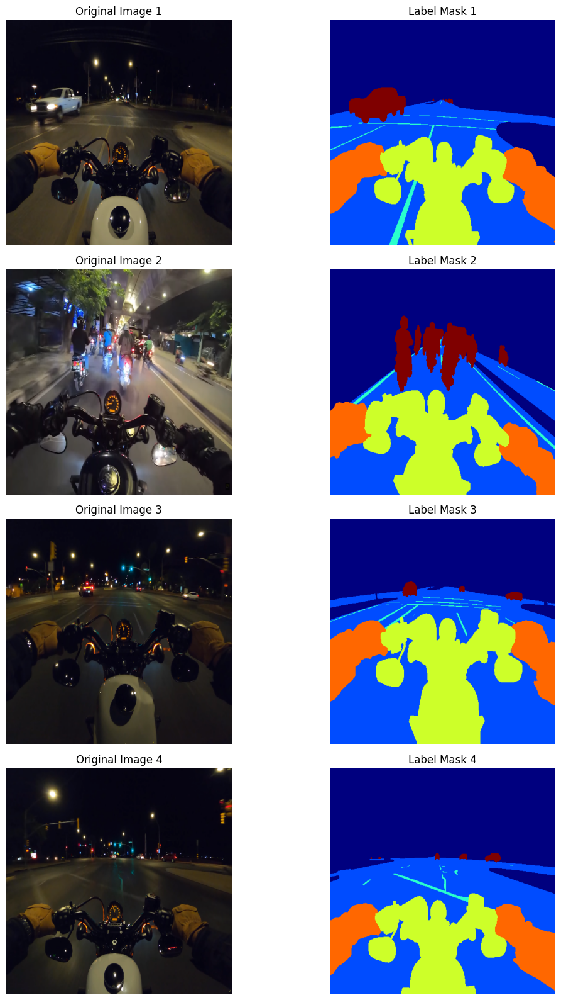

In [45]:
import matplotlib.pyplot as plt

def visualize_batch(loader, class_map):
    # 1. 배치 하나 추출
    images, masks = next(iter(loader))
    
    # 역매핑 생성 (숫자 -> 클래스 이름)
    id_to_name = {v: k for k, v in class_map.items()}
    
    # 시각화 설정 (4장 기준)
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(12, 16))
    
    for i in range(4):
        # 이미지 전처리(Normalize) 되돌리기 (시각화 용도)
        img = images[i].permute(1, 2, 0).numpy()
        img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img = np.clip(img, 0, 1)
        
        # 마스크 데이터
        mask = masks[i].numpy()
        
        # 출력
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"Original Image {i+1}")
        axes[i, 0].axis('off')
        
        # 마스크 시각화 (클래스별로 색이 다르게 보이도록 cmap 설정)
        im = axes[i, 1].imshow(mask, cmap='jet', vmin=0, vmax=len(class_map)-1)
        axes[i, 1].set_title(f"Label Mask {i+1}")
        axes[i, 1].axis('off')
        
    plt.tight_layout()
    plt.show()

# 실행
visualize_batch(train_loader, CLASS_MAP)